Mateusz Łopaciński

# Wizualizacja konwolucyjnych sieci neuronowych

## Zalecane środowisko pracy

[Google Colab](https://colab.research.google.com/). Zalecana zmiana środowiska na GPU. 

## Wprowadzenie

Neuronowe sieci konwolucyjne (CNN), to jedna z najczęściej wykorzystywanych technologi do rozpoznawania obrazów, mowy lub nawet znajdowania nowych leków. Dla bardziej złożonych problemów CNN potrafi mieć nawet setki warstw ukrytych.

Dobranie odpowiednich parametrów sieci potrafi być czasochłonne przez długi okres trenowania. Wizulazacja dostarcza narzędzii, pozwalające wykryć problemy, które CNN ma podczas uczenia i ustawić opdowiednio sieć. Do takich problemów m.in. należą:
- Zanikający gradient
- Wybuchający gradient
- Reduntatne filtry
- Bierne Neurony

## TensorBoard

TensorBoard to narzędzie, służące do wizualizacji, debugowania i monitorowania procesu uczenia się maszynowego, szczególnie w kontekście biblioteki TensorFlow. Jest to integralna część ekosystemu TensorFlow, która umożliwia interaktywną analizę danych oraz modeli uczenia maszynowego.

## Zasada działania

TensorBoard pobiera informację z lokalnego folderu, którego nazwę podaliśmy podczas uruchomienia programu. W folderze tym będą się najczęściej znajdować metadane, które zebraliśmy podczas trenowania sieci, choć możemy do niego zapisywać własne informacje poza uczeniem sieci.

Po uruchomieniu tesnorboard - w notebooku lub wierszu poleceń - aplikacji uruchomi serwer HTTP, który pozwoli na dostęp w dynamiczny sposób do zapisanych metadanych.

### Przykład - MNIST

Stworzyliśmy prostą sieć - z dwoma warstwami ukrytymi do rozpoznawania cyfr w zbiorze MNIST

In [1]:
import tensorflow as tf
from tensorflow import keras
from sklearn import metrics
import numpy as np

mnist = tf.keras.datasets.mnist
(X_train, y_train), (X_test, y_test) = mnist.load_data()
X_train, X_test = X_train / 255.0, X_test / 255.0
X_train, X_test = X_train[..., tf.newaxis], X_test[..., tf.newaxis]

model = tf.keras.models.Sequential([
   tf.keras.layers.Conv2D(8, kernel_size=(3, 3), input_shape=(28, 28, 1), name="Conv_1"),
   tf.keras.layers.ReLU(name="ReLU_1"),
   tf.keras.layers.Conv2D(16, kernel_size=(3, 3), name="Conv_2"),
   tf.keras.layers.ReLU(name="ReLU_2"),
   tf.keras.layers.Flatten(name="Flatten"),
   tf.keras.layers.Dense(16, name="Dense_1"),
   tf.keras.layers.Dense(10, name="Softmax", activation='softmax')])

model.compile(optimizer='sgd',
   loss='sparse_categorical_crossentropy',
   metrics=['accuracy'])
model.summary()

2024-04-08 21:30:47.343015: E tensorflow/compiler/xla/stream_executor/cuda/cuda_dnn.cc:9342] Unable to register cuDNN factory: Attempting to register factory for plugin cuDNN when one has already been registered
2024-04-08 21:30:47.343187: E tensorflow/compiler/xla/stream_executor/cuda/cuda_fft.cc:609] Unable to register cuFFT factory: Attempting to register factory for plugin cuFFT when one has already been registered
2024-04-08 21:30:47.343635: E tensorflow/compiler/xla/stream_executor/cuda/cuda_blas.cc:1518] Unable to register cuBLAS factory: Attempting to register factory for plugin cuBLAS when one has already been registered
2024-04-08 21:30:47.409611: I tensorflow/core/platform/cpu_feature_guard.cc:182] This TensorFlow binary is optimized to use available CPU instructions in performance-critical operations.
To enable the following instructions: AVX2 FMA, in other operations, rebuild TensorFlow with the appropriate compiler flags.
2024-04-08 21:30:48.799721: W tensorflow/compiler/

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 Conv_1 (Conv2D)             (None, 26, 26, 8)         80        
                                                                 
 ReLU_1 (ReLU)               (None, 26, 26, 8)         0         
                                                                 
 Conv_2 (Conv2D)             (None, 24, 24, 16)        1168      
                                                                 
 ReLU_2 (ReLU)               (None, 24, 24, 16)        0         
                                                                 
 Flatten (Flatten)           (None, 9216)              0         
                                                                 
 Dense_1 (Dense)             (None, 16)                147472    
                                                                 
 Softmax (Dense)             (None, 10)                1

2024-04-08 21:30:51.304021: I tensorflow/compiler/xla/stream_executor/cuda/cuda_gpu_executor.cc:880] could not open file to read NUMA node: /sys/bus/pci/devices/0000:01:00.0/numa_node
Your kernel may have been built without NUMA support.
2024-04-08 21:30:52.023978: I tensorflow/compiler/xla/stream_executor/cuda/cuda_gpu_executor.cc:880] could not open file to read NUMA node: /sys/bus/pci/devices/0000:01:00.0/numa_node
Your kernel may have been built without NUMA support.
2024-04-08 21:30:52.024124: I tensorflow/compiler/xla/stream_executor/cuda/cuda_gpu_executor.cc:880] could not open file to read NUMA node: /sys/bus/pci/devices/0000:01:00.0/numa_node
Your kernel may have been built without NUMA support.
2024-04-08 21:30:52.030334: I tensorflow/compiler/xla/stream_executor/cuda/cuda_gpu_executor.cc:880] could not open file to read NUMA node: /sys/bus/pci/devices/0000:01:00.0/numa_node
Your kernel may have been built without NUMA support.
2024-04-08 21:30:52.030433: I tensorflow/compile

In [2]:
# usuwamy logi z poprzednich uruchomień
!rm -rvf logs

TensorBoard zbiera informacji o sieci podczas trenowania, dzięki systemowi callbacków. Callback, który będzie zbierał informacje na temat treningu sieci przyjmyje określone parametry w konstruktorze:

- **log_dir**: określa ścieżkę do katalogu, w którym TensorBoard będzie przechowywał dane do wizualizacji
- **histogram_freq**: określa częstotliwość, z jaką mają być zapisywane histogramy wag i biasów w trakcie treningu
- **write_graph**: określa, czy ma zostać zapisany graf obliczeniowy modelu do katalogu logów
- **write_images**: określa, czy mają być zapisywane obrazy reprezentujące grafy w TensorBoard
- **update_freq**: określa częstotliwość, z jaką TensorBoard będzie aktualizować dane wizualizacyjne.
- **profile_batch**: określa profilowanie wybranych partii danych podczas treningu w celu analizy wydajności.
- **embeddings_freq**: określa częstotliwość (w epokach), z jaką będą wizualizowane warstwy.

In [3]:
from tensorflow.keras.callbacks import TensorBoard

log_folder = 'logs'

callbacks = [TensorBoard(log_dir=log_folder,
                         histogram_freq=1,
                         write_graph=True,
                         write_images=True,
                         update_freq='epoch',
                         profile_batch=2,
                         embeddings_freq=1)]

2024-04-08 21:31:10.994558: I tensorflow/tsl/profiler/lib/profiler_session.cc:104] Profiler session initializing.
2024-04-08 21:31:10.994612: I tensorflow/tsl/profiler/lib/profiler_session.cc:119] Profiler session started.
2024-04-08 21:31:10.994912: I tensorflow/compiler/xla/backends/profiler/gpu/cupti_tracer.cc:1694] Profiler found 1 GPUs
2024-04-08 21:31:11.026029: E tensorflow/compiler/xla/backends/profiler/gpu/cupti_error_manager.cc:194] cuptiSubscribe: error 15: CUPTI_ERROR_NOT_INITIALIZED
2024-04-08 21:31:11.026133: E tensorflow/compiler/xla/backends/profiler/gpu/cupti_error_manager.cc:459] cuptiGetResultString: ignored due to a previous error.
2024-04-08 21:31:11.026177: E tensorflow/compiler/xla/backends/profiler/gpu/cupti_tracer.cc:1746] function cupti_interface_->Subscribe( &subscriber_, (CUpti_CallbackFunc)ApiCallback, this)failed with error 
2024-04-08 21:31:11.026318: I tensorflow/tsl/profiler/lib/profiler_session.cc:131] Profiler session tear down.
2024-04-08 21:31:11.02

Załadujmy rozszerzenie tensorboard i uruchommy go dla folderu, gdzie zapisalismy logi.

In [4]:
%load_ext tensorboard

In [5]:
tensorboard --logdir={log_folder}

Launching TensorBoard...

Wytrenujmy sieć z callbackiem

In [6]:
# proszę wytrenować model, liczba epok = 3, validation_split 20%
model.fit(X_train, y_train,
          epochs=3,
          validation_split=0.2,
          callbacks=callbacks)

2024-04-08 21:31:23.104067: I tensorflow/tsl/platform/default/subprocess.cc:304] Start cannot spawn child process: No such file or directory


Epoch 1/3


2024-04-08 21:31:23.855740: I tensorflow/compiler/xla/stream_executor/cuda/cuda_dnn.cc:442] Loaded cuDNN version 8907
2024-04-08 21:31:24.014650: I tensorflow/tsl/platform/default/subprocess.cc:304] Start cannot spawn child process: No such file or directory
2024-04-08 21:31:24.292090: I tensorflow/compiler/xla/service/service.cc:168] XLA service 0x7fba95f095e0 initialized for platform CUDA (this does not guarantee that XLA will be used). Devices:
2024-04-08 21:31:24.292137: I tensorflow/compiler/xla/service/service.cc:176]   StreamExecutor device (0): NVIDIA GeForce RTX 3090, Compute Capability 8.6
2024-04-08 21:31:24.389043: I ./tensorflow/compiler/jit/device_compiler.h:186] Compiled cluster using XLA!  This line is logged at most once for the lifetime of the process.


  32/1500 [..............................] - ETA: 7s - loss: 2.2841 - accuracy: 0.1543

2024-04-08 21:31:25.077582: I tensorflow/tsl/profiler/lib/profiler_session.cc:104] Profiler session initializing.
2024-04-08 21:31:25.077621: I tensorflow/tsl/profiler/lib/profiler_session.cc:119] Profiler session started.
2024-04-08 21:31:25.077638: E tensorflow/compiler/xla/backends/profiler/gpu/cupti_error_manager.cc:135] cuptiGetTimestamp: ignored due to a previous error.
2024-04-08 21:31:25.077644: E tensorflow/compiler/xla/backends/profiler/gpu/cupti_error_manager.cc:186] cuptiSubscribe: ignored due to a previous error.
2024-04-08 21:31:25.077648: E tensorflow/compiler/xla/backends/profiler/gpu/cupti_error_manager.cc:459] cuptiGetResultString: ignored due to a previous error.
2024-04-08 21:31:25.077652: E tensorflow/compiler/xla/backends/profiler/gpu/cupti_tracer.cc:1746] function cupti_interface_->Subscribe( &subscriber_, (CUpti_CallbackFunc)ApiCallback, this)failed with error 
2024-04-08 21:31:25.084882: I tensorflow/tsl/profiler/lib/profiler_session.cc:70] Profiler session col

1500/1500 [==============================] - 10s 5ms/step - loss: 0.5246 - accuracy: 0.8468 - val_loss: 0.2732 - val_accuracy: 0.9244
Epoch 2/3
1500/1500 [==============================] - 8s 5ms/step - loss: 0.2569 - accuracy: 0.9257 - val_loss: 0.2014 - val_accuracy: 0.9424
Epoch 3/3
1500/1500 [==============================] - 8s 5ms/step - loss: 0.1590 - accuracy: 0.9543 - val_loss: 0.1245 - val_accuracy: 0.9656


Podczas treningu na bierząco możemy obserwować postępy trenowania sieci

Callback oferuje następujące panele

#### TensorBoard Scalars
##### Pokazuje zmiany strat i metryk na przestrzeni epok. Można go używać do śledzenia innych wartości skalarnych, takich jak szybkość uczenia się i prędkość treningu.

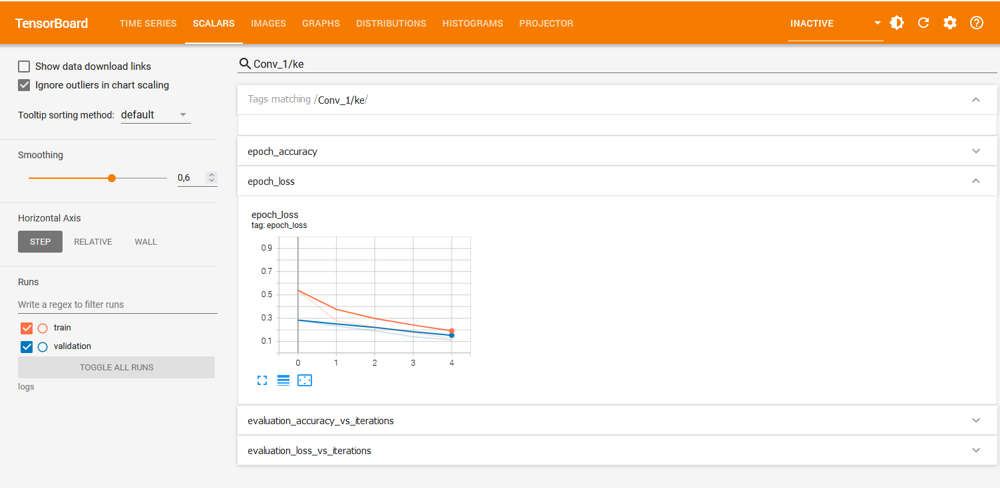

#### TensorBoard Images
##### Pokazuje wagi filtrów w poszczególnych epokach. Może służyć również do pokazywania innych obrazów wgranych "ręcznie"

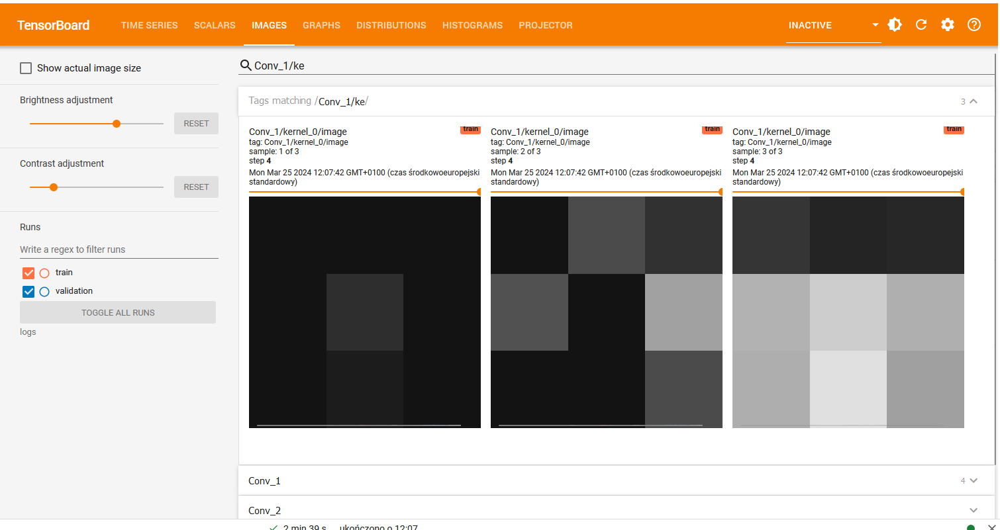

#### TensorBoard Graphs
##### Pokazuje model sieci


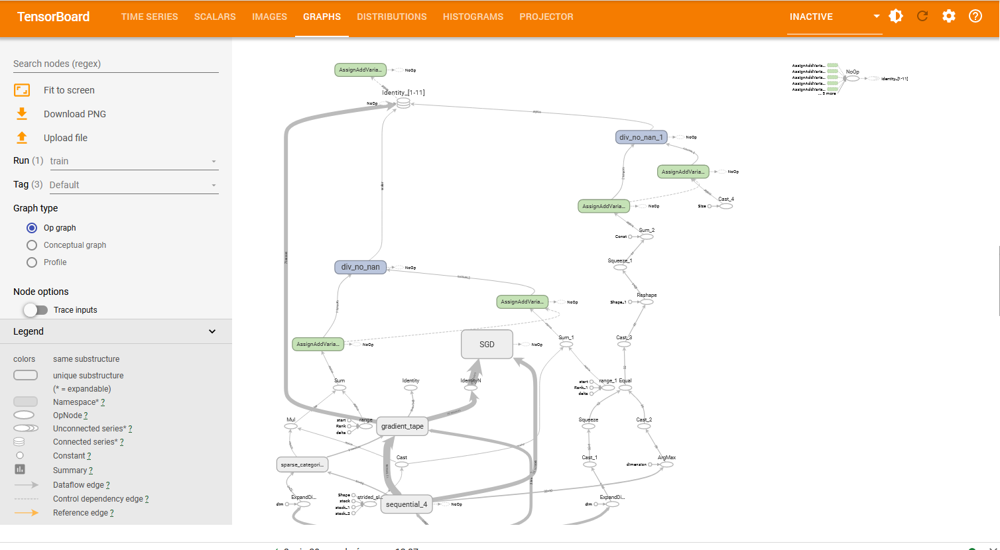

#### TensorBoard Distributions
Przedstawia rozkład wag w CNN na przestrzeni epok

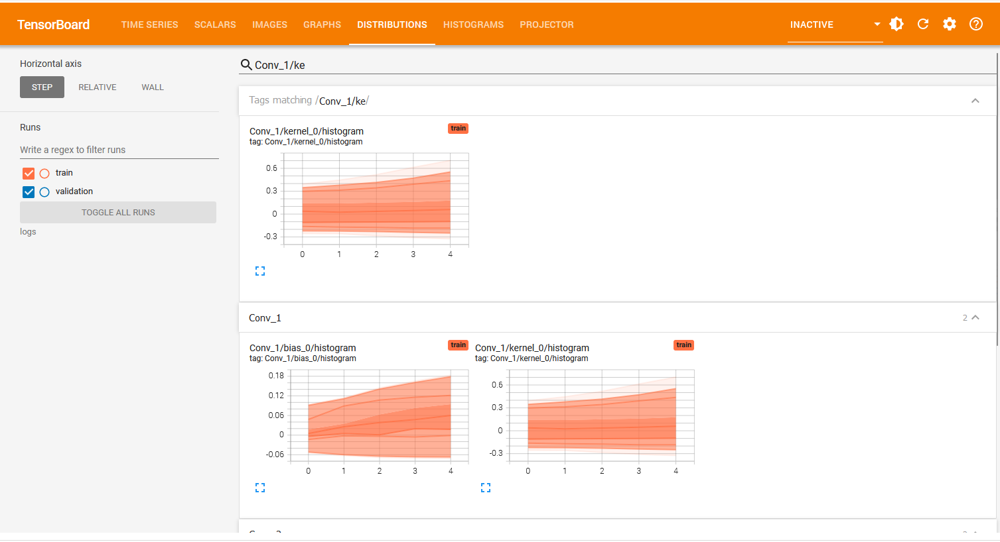


#### TensorBoard Histograms
Przedstawia histogram wag na przestrzeni epok

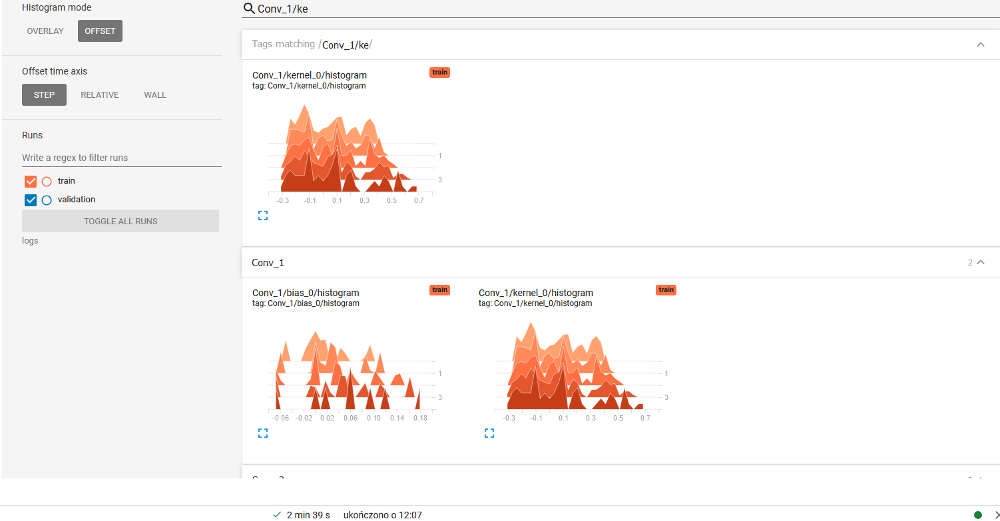

### Prezentowanie własnych danych w TensorBoard

TensorBoard oferuje szybkie prezentowanie własnych danych. Przykładowo - wgrajmy kilika obrazów Mnista ze zbioru trenigowego

In [7]:
file_writer = tf.summary.create_file_writer(log_folder)
with file_writer.as_default():
  for i, x in enumerate(X_train[:10]):
    tf.summary.image(f"MINIST_TRAIN/sample_{i}", tf.reshape(x, (1, 28, 28, 1)), step=0)

Widok po odświeżeniu TensorBoard-a

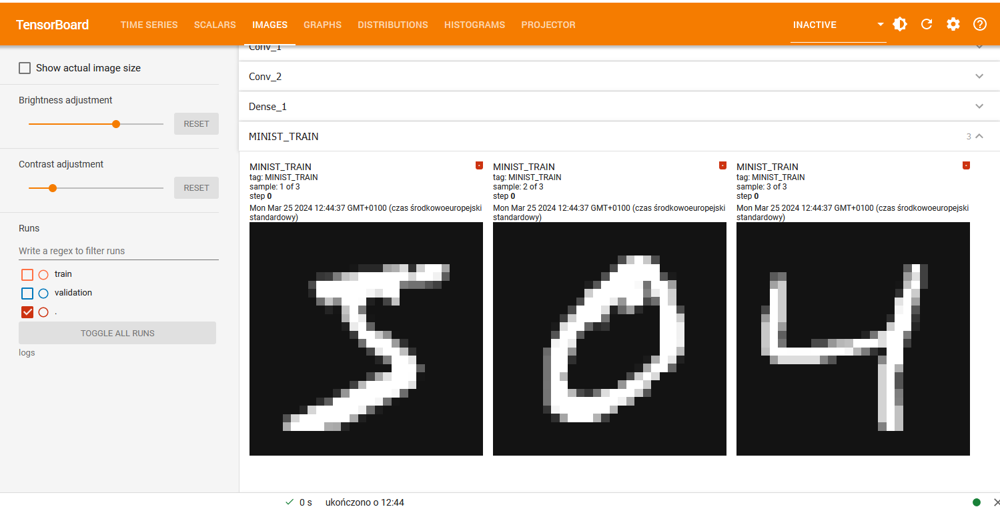

#### Logowanie własnych danych w callbacku

Podczas treningu możemy zapisywać własne dane do TensorBoardu. Spróbujmy wygenerować co każdą epokę confussion matrix

Ponownie stwórzmy nie wytrenowaną sieć

In [8]:
model = tf.keras.models.Sequential([
   tf.keras.layers.Conv2D(8, kernel_size=(3, 3), input_shape=(28, 28, 1), name="Conv_1"),
   tf.keras.layers.ReLU(name="ReLU_1"),
   tf.keras.layers.Conv2D(16, kernel_size=(3, 3), name="Conv_2"),
   tf.keras.layers.ReLU(name="ReLU_2"),
   tf.keras.layers.Flatten(name="Flatten"),
   tf.keras.layers.Dense(16, name="Dense_1"),
   tf.keras.layers.ReLU(name="ReLU_3"),
   tf.keras.layers.Dense(10, name="Softmax", activation='softmax')])

model.compile(optimizer='sgd',
   loss='sparse_categorical_crossentropy',
   metrics=['accuracy'])

model.summary()

Model: "sequential_1"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 Conv_1 (Conv2D)             (None, 26, 26, 8)         80        
                                                                 
 ReLU_1 (ReLU)               (None, 26, 26, 8)         0         
                                                                 
 Conv_2 (Conv2D)             (None, 24, 24, 16)        1168      
                                                                 
 ReLU_2 (ReLU)               (None, 24, 24, 16)        0         
                                                                 
 Flatten (Flatten)           (None, 9216)              0         
                                                                 
 Dense_1 (Dense)             (None, 16)                147472    
                                                                 
 ReLU_3 (ReLU)               (None, 16)               

Usuńmy stare logi

In [9]:
!rm -rvf logs

removed 'logs/events.out.tfevents.1712604717.MatiPl01PC.81098.2.v2'
removed 'logs/plugins/profile/2024_04_08_21_31_25/MatiPl01PC.xplane.pb'
removed directory 'logs/plugins/profile/2024_04_08_21_31_25'
removed directory 'logs/plugins/profile'
removed directory 'logs/plugins'
removed 'logs/projector_config.pbtxt'
removed 'logs/train/checkpoint'
removed 'logs/train/events.out.tfevents.1712604682.MatiPl01PC.81098.0.v2'
removed 'logs/train/keras_embedding.ckpt-0.data-00000-of-00001'
removed 'logs/train/keras_embedding.ckpt-0.index'
removed 'logs/train/keras_embedding.ckpt-1.data-00000-of-00001'
removed 'logs/train/keras_embedding.ckpt-1.index'
removed 'logs/train/keras_embedding.ckpt-2.data-00000-of-00001'
removed 'logs/train/keras_embedding.ckpt-2.index'
removed directory 'logs/train'
removed 'logs/validation/events.out.tfevents.1712604691.MatiPl01PC.81098.1.v2'
removed directory 'logs/validation'
removed directory 'logs'


In [10]:
import io
import itertools
import matplotlib.pyplot as plt

#Konwersja wykresu do tensora, gotowego do wyświetlanie przez tensorflow
def plot_to_image(figure):
    buf = io.BytesIO()
    plt.savefig(buf, format='png')
    plt.close(figure)
    buf.seek(0)

    digit = tf.image.decode_png(buf.getvalue(), channels=4)
    digit = tf.expand_dims(digit, 0)

    return digit

In [11]:
# Funkcja do rysowania wykresu confusion matrix
def plot_confusion_matrix(cm, class_names, size = 8):
    figure = plt.figure(figsize=(size, size))
    plt.imshow(cm, interpolation='nearest', cmap=plt.cm.Accent)
    plt.title("Confusion matrix")
    plt.colorbar()
    tick_marks = np.arange(len(class_names))
    plt.xticks(tick_marks, class_names, rotation=45)
    plt.yticks(tick_marks, class_names)

    cm = np.around(cm.astype('float') / cm.sum(axis=1)[:, np.newaxis], decimals=2)
    threshold = cm.max() / 2.

    for i, j in itertools.product(range(cm.shape[0]), range(cm.shape[1])):
        color = "white" if cm[i, j] > threshold else "black"
        plt.text(j, i, cm[i, j], horizontalalignment="center", color=color)

    plt.tight_layout()
    plt.ylabel('True label')
    plt.xlabel('Predicted label')

    return figure

In [12]:
class_names = ['Zero','One','Two','Three','Four','Five','Six','Seven','Eight','Nine']

file_writer = tf.summary.create_file_writer(log_folder)

#Callaback do tworzenia confusion matrix i zapiswaniem jej do logów
def log_confusion_matrix(epoch, logs):
    predictions = model.predict(X_test)
    predictions = np.argmax(predictions, axis=1)

    cm = metrics.confusion_matrix(y_test, predictions)
    figure = plot_confusion_matrix(cm, class_names=class_names)
    cm_image = plot_to_image(figure)

    with file_writer.as_default():
        tf.summary.image("Confusion Matrix", cm_image, step=epoch)

In [13]:
callbacks = [
   TensorBoard(log_dir=log_folder,
               histogram_freq=1,
               write_graph=True,
               write_images=True,
               update_freq='epoch',
               profile_batch=2,
               embeddings_freq=1),
   keras.callbacks.LambdaCallback(on_epoch_end=log_confusion_matrix)
]

model.fit(X_train, y_train,
          epochs=3,
          validation_split=0.2,
          callbacks=callbacks)

2024-04-08 21:32:13.538663: I tensorflow/tsl/profiler/lib/profiler_session.cc:104] Profiler session initializing.
2024-04-08 21:32:13.538701: I tensorflow/tsl/profiler/lib/profiler_session.cc:119] Profiler session started.
2024-04-08 21:32:13.538726: E tensorflow/compiler/xla/backends/profiler/gpu/cupti_error_manager.cc:135] cuptiGetTimestamp: ignored due to a previous error.
2024-04-08 21:32:13.538732: E tensorflow/compiler/xla/backends/profiler/gpu/cupti_error_manager.cc:186] cuptiSubscribe: ignored due to a previous error.
2024-04-08 21:32:13.538736: E tensorflow/compiler/xla/backends/profiler/gpu/cupti_error_manager.cc:459] cuptiGetResultString: ignored due to a previous error.
2024-04-08 21:32:13.538740: E tensorflow/compiler/xla/backends/profiler/gpu/cupti_tracer.cc:1746] function cupti_interface_->Subscribe( &subscriber_, (CUpti_CallbackFunc)ApiCallback, this)failed with error 
2024-04-08 21:32:13.538953: I tensorflow/tsl/profiler/lib/profiler_session.cc:131] Profiler session te

Epoch 1/3
  20/1500 [..............................] - ETA: 12s - loss: 2.2912 - accuracy: 0.1250

2024-04-08 21:32:14.899105: I tensorflow/tsl/profiler/lib/profiler_session.cc:104] Profiler session initializing.
2024-04-08 21:32:14.899142: I tensorflow/tsl/profiler/lib/profiler_session.cc:119] Profiler session started.
2024-04-08 21:32:14.899159: E tensorflow/compiler/xla/backends/profiler/gpu/cupti_error_manager.cc:135] cuptiGetTimestamp: ignored due to a previous error.
2024-04-08 21:32:14.899164: E tensorflow/compiler/xla/backends/profiler/gpu/cupti_error_manager.cc:186] cuptiSubscribe: ignored due to a previous error.
2024-04-08 21:32:14.899167: E tensorflow/compiler/xla/backends/profiler/gpu/cupti_error_manager.cc:459] cuptiGetResultString: ignored due to a previous error.
2024-04-08 21:32:14.899172: E tensorflow/compiler/xla/backends/profiler/gpu/cupti_tracer.cc:1746] function cupti_interface_->Subscribe( &subscriber_, (CUpti_CallbackFunc)ApiCallback, this)failed with error 
2024-04-08 21:32:14.933125: I tensorflow/tsl/profiler/lib/profiler_session.cc:70] Profiler session col

1500/1500 [==============================] - 11s 7ms/step - loss: 0.5492 - accuracy: 0.8279 - val_loss: 0.2756 - val_accuracy: 0.9173
Epoch 2/3
1500/1500 [==============================] - 10s 7ms/step - loss: 0.2454 - accuracy: 0.9282 - val_loss: 0.2109 - val_accuracy: 0.9395
Epoch 3/3
1500/1500 [==============================] - 9s 6ms/step - loss: 0.1789 - accuracy: 0.9480 - val_loss: 0.1525 - val_accuracy: 0.9553


Oczekiwany wynik w tensorboard

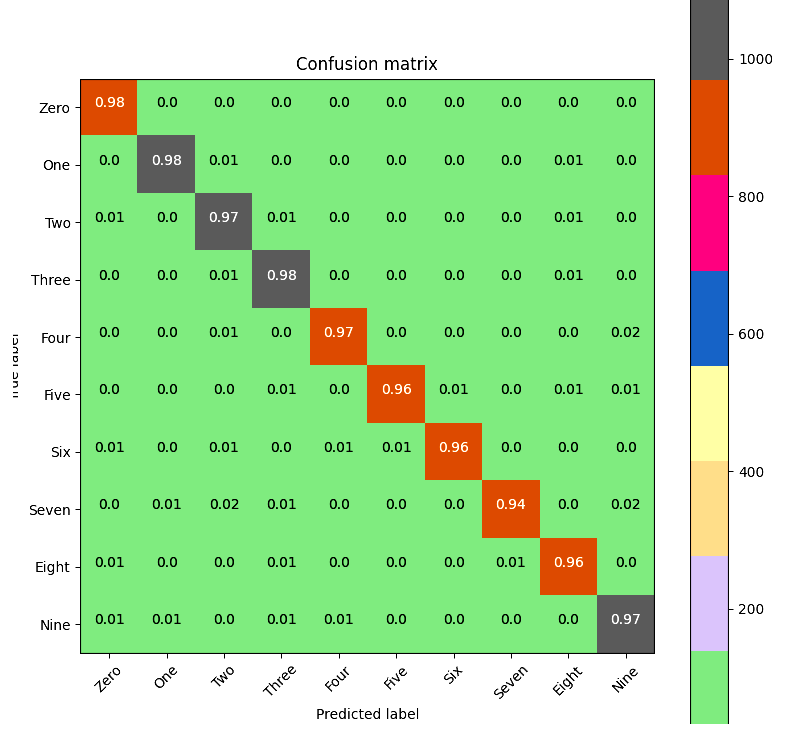

#### Wizualizacja aktywacji warstw

In [14]:
def plot_activation_layers(model, sample_data, log_folder):
  activation_model = tf.keras.Model(inputs=model.input, outputs=[layer.output for layer in model.layers])
  activations = activation_model.predict(sample_data)
  file_writer = tf.summary.create_file_writer(log_folder)
  for layer_activation, layer_name in zip(activations, model.layers):
    with file_writer.as_default():
        for i in range(layer_activation.shape[-1]):
          if(len(layer_activation.shape) == 4):
            tf.summary.image(layer_name.name + f'/activations/filter_{i}', layer_activation[:, :, :, i][..., tf.newaxis], step=0)

In [15]:
plot_activation_layers(model, X_train[:10], log_folder)

1/1 [==============================] - 0s 180ms/step


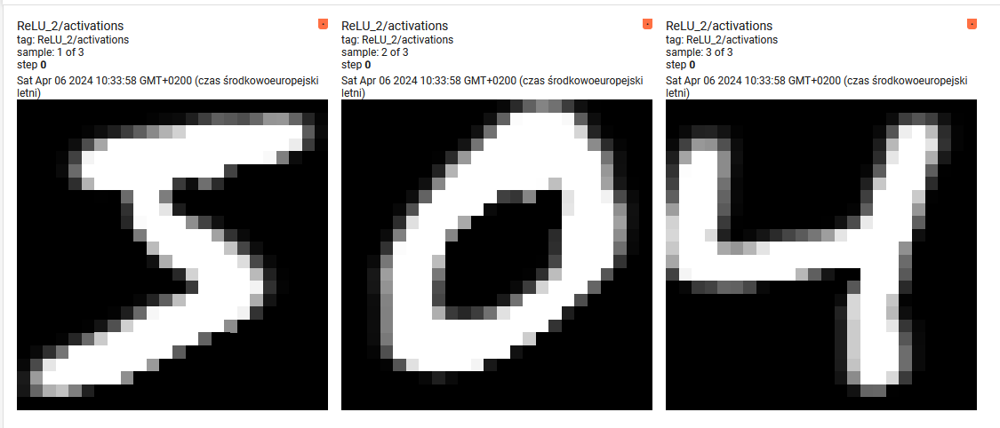

# Ćwiczenie Olivetti Faces

Olivetti Faces to zbiór danych zawierający 400 obrazów twarzy 40 osób (64x64) wykonanych w różnych kierunkach oświetlenia. Został stworzony przez Olivetti Research Laboratory i jest popularnym zbiorem danych w dziedzinie rozpoznawania twarzy i uczenia maszynowego

Wyczyszczenie poprzednich logów

In [16]:
!rm -rvf logs_olivetti_1

In [17]:
!rm -rvf logs_olivetti_2

In [18]:
!rm -rvf logs_olivetti_3

Pobranie danych

In [19]:
from sklearn.datasets import fetch_olivetti_faces

faces = fetch_olivetti_faces()

X = faces.data
y = faces.target

downloading Olivetti faces from https://ndownloader.figshare.com/files/5976027 to /home/mateu/scikit_learn_data


In [20]:
print(X.shape)
X = tf.reshape(X, [X.shape[0], 64, 64, 1])
X.shape

(400, 4096)


TensorShape([400, 64, 64, 1])

Podział na zbiór walidacyjny i treningowy

In [21]:
from sklearn.model_selection import train_test_split

x_train, x_valid, y_train, y_valid = train_test_split(X.numpy(), y, test_size=0.2, shuffle= True, random_state = 123)

#### Zadanie 1

Dla folderu **logs_olivetti_1** uruchom tensorboard i załaduje do niego kilka zdjęć ze zbioru uczącego

In [23]:
# proszę uzupełnić ścieżkę do folderu z logami
log_folder = './log_folder'

In [24]:
tensorboard --logdir={log_folder}

ERROR: Failed to launch TensorBoard (exited with 1).
Contents of stderr:
2024-04-08 21:34:37.916960: E tensorflow/compiler/xla/stream_executor/cuda/cuda_dnn.cc:9342] Unable to register cuDNN factory: Attempting to register factory for plugin cuDNN when one has already been registered
2024-04-08 21:34:37.917010: E tensorflow/compiler/xla/stream_executor/cuda/cuda_fft.cc:609] Unable to register cuFFT factory: Attempting to register factory for plugin cuFFT when one has already been registered
2024-04-08 21:34:37.917080: E tensorflow/compiler/xla/stream_executor/cuda/cuda_blas.cc:1518] Unable to register cuBLAS factory: Attempting to register factory for plugin cuBLAS when one has already been registered
2024-04-08 21:34:37.927382: I tensorflow/core/platform/cpu_feature_guard.cc:182] This TensorFlow binary is optimized to use available CPU instructions in performance-critical operations.
To enable the following instructions: AVX2 FMA, in other operations, rebuild TensorFlow with the appro

In [25]:
file_writer = tf.summary.create_file_writer(log_folder)
with file_writer.as_default():
  for i, x in enumerate(x_valid[:20]):
    tf.summary.image(f"OLIVETTI_SAMPLE/{i}", tf.reshape(x, (1, 64, 64, 1)), step=0)

Oczekiwany wynik

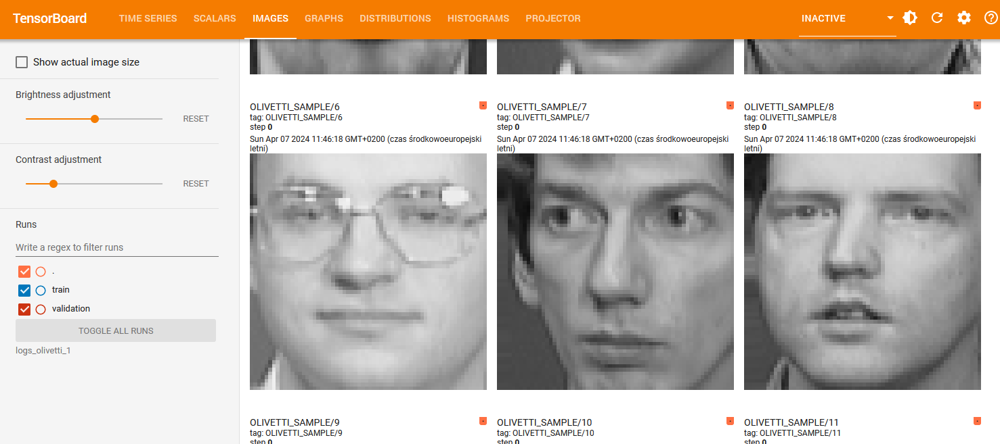

#### Zadanie 2

Przygotuj funkcje **log_confusion_matrix_faces**, tak aby działała dla zbioru Olivetti Faces

In [28]:
class_names = [f"face {face_id}" for face_id in np.unique(y)]

#Callaback do tworzenia confusion matrix i zapiswaniem jej do logów
def log_confusion_matrix_faces(epoch, logs):
    predictions = model.predict(x_train)
    predictions = np.argmax(predictions, axis=1)

    # proszę uzupełnić macierz pomyłek oraz wywołać funkcję plot_confusion_matrix
    cm = metrics.confusion_matrix(y_valid, predictions)
    figure = plot_confusion_matrix(cm, class_names=class_names)
    cm_image = plot_to_image(figure)

    with file_writer.as_default():
        tf.summary.image("Confusion Matrix", cm_image, step=epoch)

Oczekiwany wynik po treningu sieci

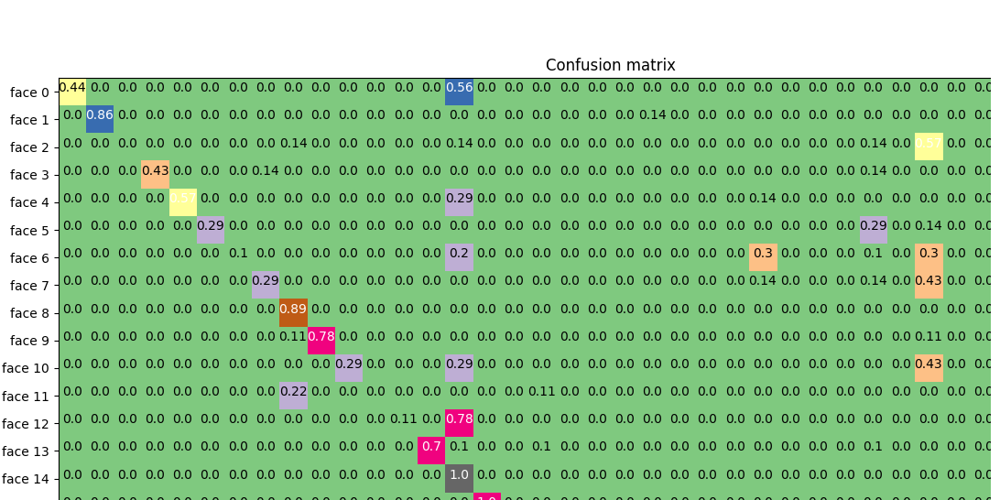

#### Zadanie 3
Utwórz callbacka do zapisywania współczynnika **Recall** dla każdej klasy po każdej epoce

In [29]:
from sklearn.metrics import recall_score

def log_recall_faces(epoch, logs):
    predictions = model.predict(y_train)
    predictions = np.argmax(predictions, axis=1)

    recall_per_class = recall_score(y_valid, predictions, average=None)
    
    with file_writer.as_default():
        for i, recall in enumerate(recall_per_class):
            tf.summary.scalar(f'recall/face_{i}', recall, step=epoch)

Oczekiwany wynik po treningu sieci

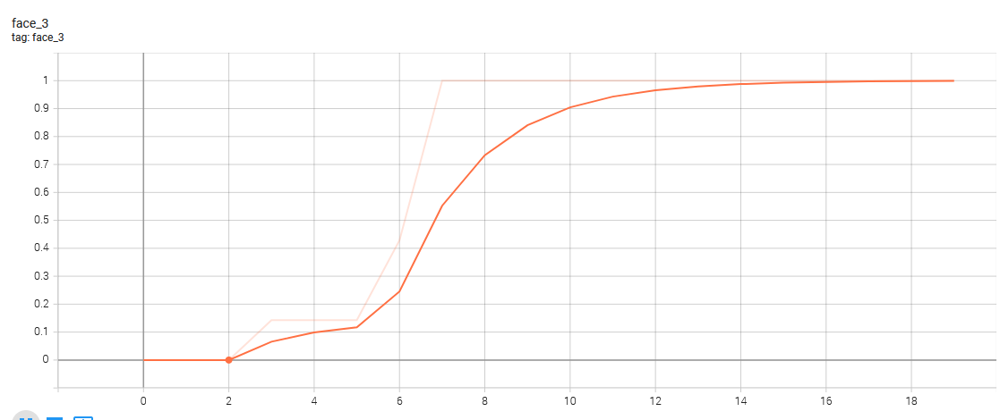

Funkcja tworząca Callbacki dla modelu

In [30]:
def get_callbacks():
  return [TensorBoard(log_dir=log_folder,
                         histogram_freq=5,
                         write_graph=False,
                         write_images=False,
                         update_freq=2,
                         profile_batch=2,
                         embeddings_freq=5),
                         keras.callbacks.LambdaCallback(on_epoch_end=log_confusion_matrix_faces),
                         keras.callbacks.LambdaCallback(on_epoch_end=log_recall_faces)]

#### Zadanie 4
Stworzyliśmy przykładowego CNN dla rozpoznawania twarzy naszego zbioru uczącego. Wytrenuj go dla 20 epok i zinterpretuj wyniki. Napisz, jak można podnieśc dokładność na zbiorze walidacyjnym

### Podsumowanie przykładowego modelu

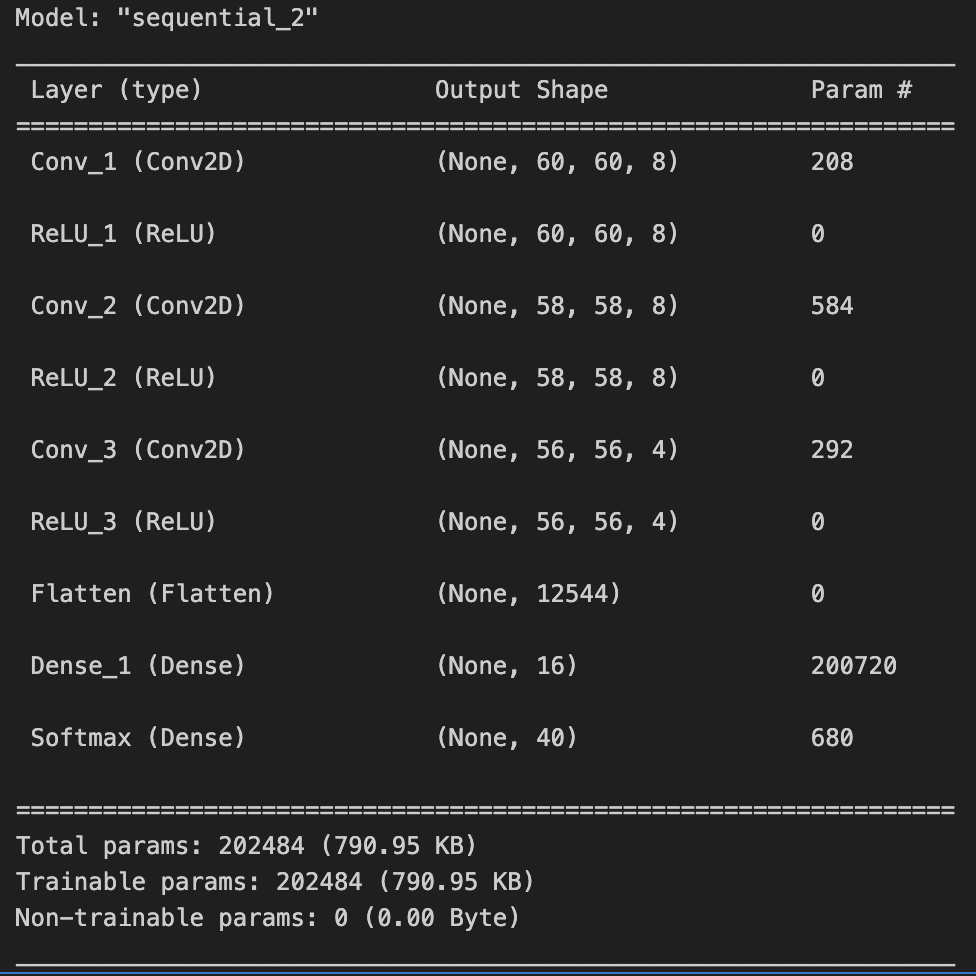

In [50]:
# proszę stworzyć model, którego podsumowanie będzie adekwatne do przedstawionego wyżej modelu
model = tf.keras.models.Sequential([
    tf.keras.layers.Conv2D(8, kernel_size=(5, 5), input_shape=(64, 64, 1), name="Conv_1"),
    tf.keras.layers.ReLU(name="ReLU_1"),
    tf.keras.layers.Conv2D(8, kernel_size=(3, 3), name="Conv_2"),
    tf.keras.layers.ReLU(name="ReLU_2"),
    tf.keras.layers.Conv2D(4, kernel_size=(3, 3), name="Conv_3"),
    tf.keras.layers.ReLU(name="ReLU_3"),
    
    tf.keras.layers.Flatten(name="Flatten"),
    tf.keras.layers.Dense(16, name="Dense_1"),
    tf.keras.layers.Dense(40, name="Softmax", activation='softmax')
])

model.compile(optimizer='sgd',
    loss='sparse_categorical_crossentropy',
    metrics=['accuracy']
)
model.summary()

Model: "sequential_17"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 Conv_1 (Conv2D)             (None, 60, 60, 8)         208       
                                                                 
 ReLU_1 (ReLU)               (None, 60, 60, 8)         0         
                                                                 
 Conv_2 (Conv2D)             (None, 58, 58, 8)         584       
                                                                 
 ReLU_2 (ReLU)               (None, 58, 58, 8)         0         
                                                                 
 Conv_3 (Conv2D)             (None, 56, 56, 4)         292       
                                                                 
 ReLU_3 (ReLU)               (None, 56, 56, 4)         0         
                                                                 
 Flatten (Flatten)           (None, 12544)           

In [51]:
# proszę wytrenować model, wykorzystując funkcję get_callbacks(), ilość epok powinna wynosić 20, batch_size 4, validation_data=(x_valid, y_valid)
model.fit(x_train, y_train, 
          epochs=20, 
          batch_size=4, 
          validation_data=(x_valid, y_valid), 
          callbacks=get_callbacks())

Epoch 1/20


2024-04-08 21:44:17.292667: I tensorflow/tsl/profiler/lib/profiler_session.cc:104] Profiler session initializing.
2024-04-08 21:44:17.292703: I tensorflow/tsl/profiler/lib/profiler_session.cc:119] Profiler session started.
2024-04-08 21:44:17.292735: E tensorflow/compiler/xla/backends/profiler/gpu/cupti_error_manager.cc:135] cuptiGetTimestamp: ignored due to a previous error.
2024-04-08 21:44:17.292750: E tensorflow/compiler/xla/backends/profiler/gpu/cupti_error_manager.cc:186] cuptiSubscribe: ignored due to a previous error.
2024-04-08 21:44:17.292760: E tensorflow/compiler/xla/backends/profiler/gpu/cupti_error_manager.cc:459] cuptiGetResultString: ignored due to a previous error.
2024-04-08 21:44:17.292794: E tensorflow/compiler/xla/backends/profiler/gpu/cupti_tracer.cc:1746] function cupti_interface_->Subscribe( &subscriber_, (CUpti_CallbackFunc)ApiCallback, this)failed with error 
2024-04-08 21:44:17.293994: I tensorflow/tsl/profiler/lib/profiler_session.cc:131] Profiler session te

18/80 [=====>........................] - ETA: 0s - loss: 3.6987 - accuracy: 0.0417  

2024-04-08 21:44:18.397757: I tensorflow/tsl/profiler/lib/profiler_session.cc:104] Profiler session initializing.
2024-04-08 21:44:18.397807: I tensorflow/tsl/profiler/lib/profiler_session.cc:119] Profiler session started.
2024-04-08 21:44:18.397831: E tensorflow/compiler/xla/backends/profiler/gpu/cupti_error_manager.cc:135] cuptiGetTimestamp: ignored due to a previous error.
2024-04-08 21:44:18.397838: E tensorflow/compiler/xla/backends/profiler/gpu/cupti_error_manager.cc:186] cuptiSubscribe: ignored due to a previous error.
2024-04-08 21:44:18.397842: E tensorflow/compiler/xla/backends/profiler/gpu/cupti_error_manager.cc:459] cuptiGetResultString: ignored due to a previous error.
2024-04-08 21:44:18.397847: E tensorflow/compiler/xla/backends/profiler/gpu/cupti_tracer.cc:1746] function cupti_interface_->Subscribe( &subscriber_, (CUpti_CallbackFunc)ApiCallback, this)failed with error 
2024-04-08 21:44:18.428770: I tensorflow/tsl/profiler/lib/profiler_session.cc:70] Profiler session col

10/10 [==============================] - 0s 3ms/steposs: 3.6916 - accuracy: 0.04


ValueError: Found input variables with inconsistent numbers of samples: [80, 320]

#### Zadanie 5
Wzorując się na poprzedniej sieci wykonaj kolejno

Utwórz nowego **file_writer** dla folderu **logs_olivetti_2**

In [30]:
log_folder = #TODO
file_writer = tf.summary.create_file_writer(#TODO)

Uruchom tensorboard dla podanego wcześniej folderu

In [31]:
#TODO

<IPython.core.display.Javascript object>

Wzorując się na poprzedniej sieci, zmniejsz ilośc parametrów uczących. Użyj **strides = 2** dla dwóch pierwszych warstw. Zinterpretuj wyniki

### Podsumowanie przykładowego modelu z strides = 2

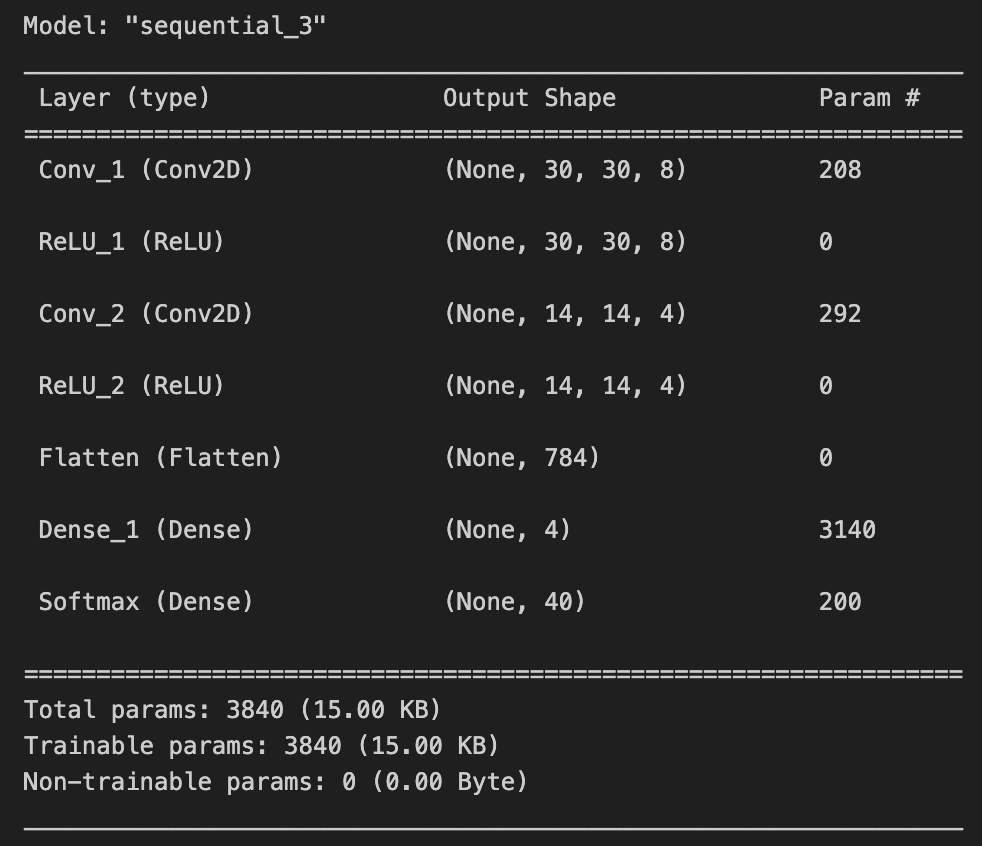

In [32]:
model = #TODO

model.compile(optimizer='sgd',
   loss='sparse_categorical_crossentropy',
   metrics=['accuracy'])
model.summary()

Model: "sequential_3"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 Conv_1 (Conv2D)             (None, 30, 30, 8)         208       
                                                                 
 ReLU_1 (ReLU)               (None, 30, 30, 8)         0         
                                                                 
 Conv_2 (Conv2D)             (None, 14, 14, 4)         292       
                                                                 
 ReLU_2 (ReLU)               (None, 14, 14, 4)         0         
                                                                 
 Flatten (Flatten)           (None, 784)               0         
                                                                 
 Dense_1 (Dense)             (None, 4)                 3140      
                                                                 
 Softmax (Dense)             (None, 40)               

In [33]:
# proszę uzupełnić bazując na poprzednim przykładzie, liczba epok powinna wynosić 30
model.fit(#TODO)

Epoch 1/30
80/80 [==============================] - 6s 66ms/step - loss: 3.6911 - accuracy: 0.0312 - val_loss: 3.6888 - val_accuracy: 0.0250
Epoch 2/30
80/80 [==============================] - 7s 94ms/step - loss: 3.6889 - accuracy: 0.0281 - val_loss: 3.6897 - val_accuracy: 0.0250
Epoch 3/30
80/80 [==============================] - 4s 51ms/step - loss: 3.6867 - accuracy: 0.0344 - val_loss: 3.6915 - val_accuracy: 0.0250
Epoch 4/30
80/80 [==============================] - 5s 60ms/step - loss: 3.6851 - accuracy: 0.0312 - val_loss: 3.6923 - val_accuracy: 0.0250
Epoch 5/30
80/80 [==============================] - 5s 65ms/step - loss: 3.6829 - accuracy: 0.0250 - val_loss: 3.6929 - val_accuracy: 0.0250
Epoch 6/30
80/80 [==============================] - 5s 64ms/step - loss: 3.6795 - accuracy: 0.0469 - val_loss: 3.6945 - val_accuracy: 0.0250
Epoch 7/30
80/80 [==============================] - 5s 61ms/step - loss: 3.6783 - accuracy: 0.0375 - val_loss: 3.6923 - val_accuracy: 0.0250
Epoch 8/30
80

#### Zadanie 6
Zapisz do tensorboard aktywacje poszczególnych warstw dla kilku przykładowych zdjęć

In [34]:
plot_activation_layers(#TODO)

1/1 [==============================] - 0s 134ms/step


Oczekiwany wynik w tensorboard

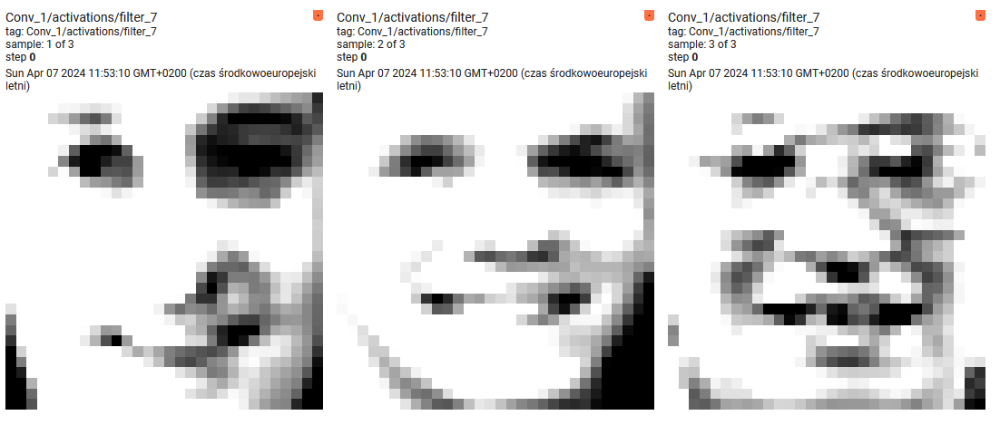

#### Zadanie 7
Na podstawie modelu z zadania 5 spróbuj dodać **Dropout**, między niektórymi warstwami i zwiększ ilośc parametrów.

Celem jest zwiększenie precyzji na zbiorze walidacyjnym, unikająć przy tym overfittingu dla zbioru testowego.

*Hint*: Zwiększ ilośc epok (do około 60)

In [35]:
log_folder = #TODO
file_writer = tf.summary.create_file_writer(#TODO)

In [36]:
#TODO

<IPython.core.display.Javascript object>

### Podsumowanie przykładowego modelu

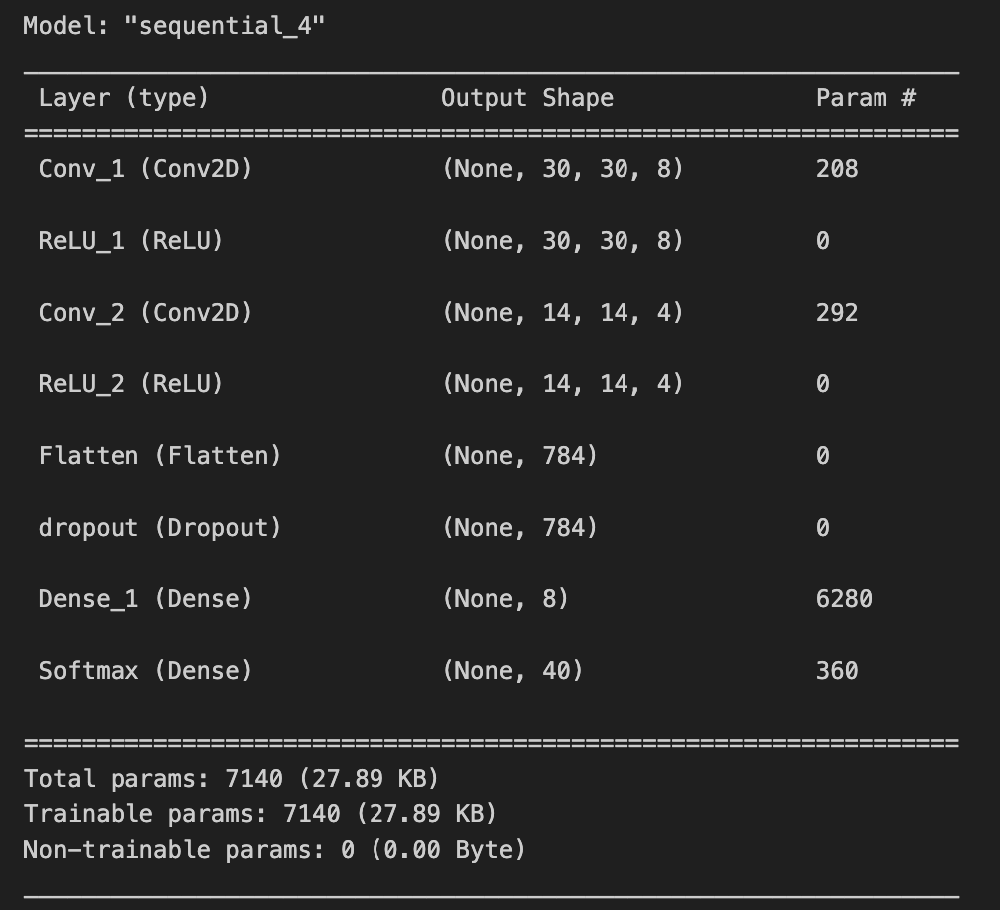

In [37]:
model = #TODO

model.compile(optimizer='sgd',
   loss='sparse_categorical_crossentropy',
   metrics=['accuracy'])
model.summary()

Model: "sequential_4"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 Conv_1 (Conv2D)             (None, 30, 30, 8)         208       
                                                                 
 ReLU_1 (ReLU)               (None, 30, 30, 8)         0         
                                                                 
 Conv_2 (Conv2D)             (None, 14, 14, 4)         292       
                                                                 
 ReLU_2 (ReLU)               (None, 14, 14, 4)         0         
                                                                 
 Flatten (Flatten)           (None, 784)               0         
                                                                 
 dropout (Dropout)           (None, 784)               0         
                                                                 
 Dense_1 (Dense)             (None, 8)                

In [38]:
# proszę uzupełnić tak jak wcześniej, liczba epok = hint do zadania
model.fit(#TODO)

Epoch 1/60
80/80 [==============================] - 10s 113ms/step - loss: 3.6940 - accuracy: 0.0250 - val_loss: 3.6945 - val_accuracy: 0.0250
Epoch 2/60
80/80 [==============================] - 4s 53ms/step - loss: 3.6885 - accuracy: 0.0125 - val_loss: 3.6938 - val_accuracy: 0.0125
Epoch 3/60
80/80 [==============================] - 4s 53ms/step - loss: 3.6860 - accuracy: 0.0312 - val_loss: 3.7083 - val_accuracy: 0.0375
Epoch 4/60
80/80 [==============================] - 5s 65ms/step - loss: 3.6849 - accuracy: 0.0281 - val_loss: 3.7116 - val_accuracy: 0.0250
Epoch 5/60
80/80 [==============================] - 8s 99ms/step - loss: 3.6661 - accuracy: 0.0656 - val_loss: 3.7422 - val_accuracy: 0.0125
Epoch 6/60
80/80 [==============================] - 5s 67ms/step - loss: 3.6681 - accuracy: 0.0406 - val_loss: 3.7621 - val_accuracy: 0.0250
Epoch 7/60
80/80 [==============================] - 4s 53ms/step - loss: 3.6418 - accuracy: 0.0344 - val_loss: 3.7274 - val_accuracy: 0.0250
Epoch 8/60


#### Zadanie dodatkowe - HParams

Kolejną zakładką w TensroBoard, jest HParams - umożliwająca porównywanie modeli dla różnych parametrów

Utwórzmy nowy folder dla logów i uruchommy TensorBoard

In [39]:
# usuwamy jeśli już istnieje
!rm -rvf logs_olivetti_hparam

removed 'logs_olivetti_hparam/2/events.out.tfevents.1712488151.47c0f7eb62d7.33660.41.v2'
removed directory 'logs_olivetti_hparam/2'
removed 'logs_olivetti_hparam/5/events.out.tfevents.1712488206.47c0f7eb62d7.33660.44.v2'
removed directory 'logs_olivetti_hparam/5'
removed 'logs_olivetti_hparam/0/events.out.tfevents.1712488117.47c0f7eb62d7.33660.39.v2'
removed directory 'logs_olivetti_hparam/0'
removed 'logs_olivetti_hparam/4/events.out.tfevents.1712488194.47c0f7eb62d7.33660.43.v2'
removed directory 'logs_olivetti_hparam/4'
removed 'logs_olivetti_hparam/events.out.tfevents.1712488089.47c0f7eb62d7.33660.38.v2'
removed 'logs_olivetti_hparam/3/events.out.tfevents.1712488172.47c0f7eb62d7.33660.42.v2'
removed directory 'logs_olivetti_hparam/3'
removed 'logs_olivetti_hparam/1/events.out.tfevents.1712488138.47c0f7eb62d7.33660.40.v2'
removed directory 'logs_olivetti_hparam/1'
removed directory 'logs_olivetti_hparam'


In [40]:
log_folder = #TODO
file_writer = tf.summary.create_file_writer(#TODO)

In [41]:
#TODO

<IPython.core.display.Javascript object>

Ustawmy parametry według, których będziemy porównywać modele - będzie to wartość **Dropoutu** oraz ilośc neuronów w warstiwe **Dense**

In [43]:
from tensorboard.plugins.hparams import api as hp

HP_NUM_UNITS = hp.HParam('num_units', hp.Discrete([4, 8, 16]))
HP_DROPOUT = hp.HParam('dropout', hp.RealInterval(0.0,0.5))

Ustalmy konfiguracje HParametrów - jakie parametry będziemy porównywać (**Dropout**, **Dense**) i jakim kryteriami (**Accuracy**)

In [44]:
METRIC_ACCURACY = 'accuracy'

with file_writer.as_default():
    hp.hparams_config(
        hparams=[#TODO],
        metrics=[hp.Metric(#TODO)],)

W pętli stórzmy dla każdego z parametrów model, wytrenujmy go i zapiszmy wyniki do logów

In [49]:
model_no = 0
for num_units in HP_NUM_UNITS.domain.values:
    for dropout_rate in np.arange(HP_DROPOUT.domain.min_value, HP_DROPOUT.domain.max_value, 0.1):
      print(f'Experiment: Dense_Number_Units={num_units} Dropout={dropout_rate}')
      model = #TODO, ten sam model z dropoutem oraz strides = 2

      model.compile(optimizer='sgd',
      loss='sparse_categorical_crossentropy',
      metrics=['accuracy'])
      model.fit(#TODO, jak w wcześniejszym przykładzie uczącym)

      _, accuracy = model.evaluate(x_valid, y_valid)
      file_writer_hparam = tf.summary.create_file_writer(f'{log_folder}/{model_no}')
      with file_writer_hparam.as_default():
        hp.hparams({
            HP_NUM_UNITS: num_units,
            HP_DROPOUT: dropout_rate
        })
        tf.summary.scalar(METRIC_ACCURACY, accuracy, step=1)
        model_no += 1

Experiment: Dense_Number_Units=4 Dropout=0.0
Epoch 1/60
80/80 [==============================] - 2s 12ms/step - loss: 3.6903 - accuracy: 0.0312 - val_loss: 3.6923 - val_accuracy: 0.0000e+00
Epoch 2/60
80/80 [==============================] - 1s 7ms/step - loss: 3.6894 - accuracy: 0.0312 - val_loss: 3.6950 - val_accuracy: 0.0000e+00
Epoch 3/60
80/80 [==============================] - 1s 7ms/step - loss: 3.6884 - accuracy: 0.0188 - val_loss: 3.6971 - val_accuracy: 0.0000e+00
Epoch 4/60
80/80 [==============================] - 1s 9ms/step - loss: 3.6875 - accuracy: 0.0250 - val_loss: 3.7003 - val_accuracy: 0.0125
Epoch 5/60
80/80 [==============================] - 1s 8ms/step - loss: 3.6863 - accuracy: 0.0344 - val_loss: 3.7025 - val_accuracy: 0.0125
Epoch 6/60
80/80 [==============================] - 1s 7ms/step - loss: 3.6859 - accuracy: 0.0250 - val_loss: 3.7039 - val_accuracy: 0.0125
Epoch 7/60
80/80 [==============================] - 0s 5ms/step - loss: 3.6847 - accuracy: 0.0375 - va

Oczekiwany wynik, proszę sprawdzić czy wyszło podobnie

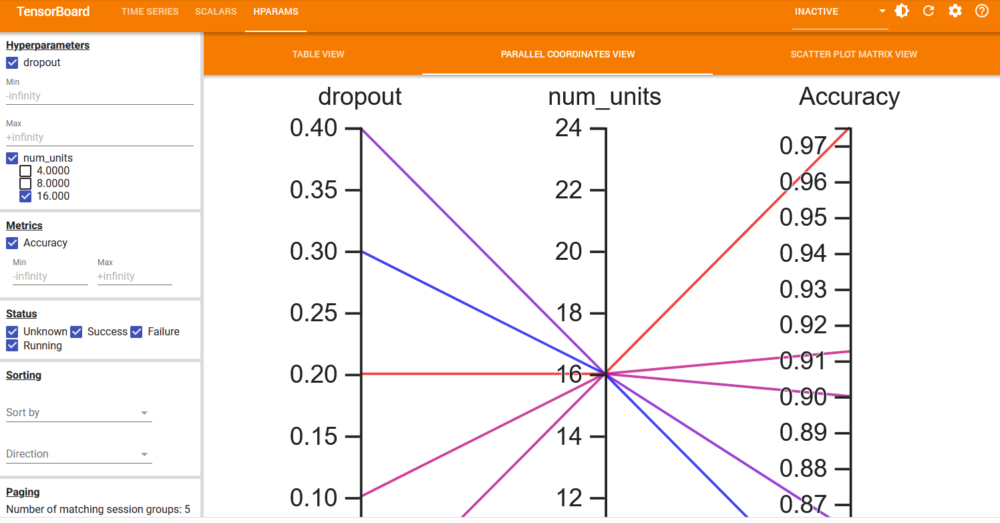